### Check the colab environment

In [1]:
!nvidia-smi

Wed Dec  1 05:21:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!nvcc  --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


In [ ]:
!cat /usr/include/x86_64-linux-gnu/cudnn_v*.h | grep CUDNN_MAJOR -A 2

#define CUDNN_MAJOR 7
#define CUDNN_MINOR 6
#define CUDNN_PATCHLEVEL 5
--
#define CUDNN_VERSION (CUDNN_MAJOR * 1000 + CUDNN_MINOR * 100 + CUDNN_PATCHLEVEL)

#include "driver_types.h"
--
#define CUDNN_MAJOR 8
#define CUDNN_MINOR 0
#define CUDNN_PATCHLEVEL 5
--
#define CUDNN_VERSION (CUDNN_MAJOR * 1000 + CUDNN_MINOR * 100 + CUDNN_PATCHLEVEL)

#endif /* CUDNN_VERSION_H */


In [ ]:
import platform
platform.platform()

'Linux-5.4.104+-x86_64-with-Ubuntu-18.04-bionic'

In [ ]:
import torch
torch.cuda.is_available()

True

### Install of Tensorflow Object Detection API

In [ ]:
## https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/install.html#tensorflow-object-detection-api-installation

In [2]:
!mkdir tensorflow
%cd tensorflow/
!git clone https://github.com/tensorflow/models.git

/content/tensorflow
Cloning into 'models'...
remote: Enumerating objects: 67475, done.
remote: Total 67475 (delta 0), reused 0 (delta 0), pack-reused 67475
Receiving objects: 100% (67475/67475), 576.21 MiB | 45.62 MiB/s, done.
Resolving deltas: 100% (47338/47338), done.


In [3]:
%cd /content/tensorflow/models/research
!protoc object_detection/protos/*.proto --python_out=.

/content/tensorflow/models/research


In [4]:
%cd /content/
!git clone https://github.com/cocodataset/cocoapi.git

/content
Cloning into 'cocoapi'...
remote: Enumerating objects: 975, done.
remote: Total 975 (delta 0), reused 0 (delta 0), pack-reused 975
Receiving objects: 100% (975/975), 11.72 MiB | 34.80 MiB/s, done.
Resolving deltas: 100% (576/576), done.


In [5]:
%cd cocoapi/PythonAPI
!make

/content/cocoapi/PythonAPI
python setup.py build_ext --inplace
running build_ext
cythoning pycocotools/_mask.pyx to pycocotools/_mask.c
/usr/local/lib/python3.7/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-Y7dWVB/python3.7-3.7.12=. -fstack-protector-strong -Wformat -Werror=format-security -g -fdebug-prefix-map=/build/python3.7-Y7dWVB/python3.7-3.7.12=. -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/python3.7/dist

In [6]:
!cp -r pycocotools /content/tensorflow/models/research/

In [7]:
%cd /content/tensorflow/models/research/
!cp object_detection/packages/tf2/setup.py .
!pip3 install --upgrade pip
!python -m pip install --use-feature=2020-resolver .

/content/tensorflow/models/research
     |████████████████████████████████| 1.7 MB 5.0 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3
Processing /content/tensorflow/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     |████████████████████████████████| 9.8 MB 8.2 MB/s            
     |████████████████████████████████| 352 kB 71.8 MB/s            
     |████████████████████████████████| 1.8 MB 62.2 MB/s            
     |████████████████████████████████| 22.7 MB 1.1 MB/s             
     |████████████████████████████████| 1.3 MB 81.6 MB/s            
     |████████████████████████████████| 1.2 MB 75.4 MB/s            
     |████████████████████████████████| 1.1 MB 84.2 MB/s            
     |████████████████████████████████| 213 kB 102.5 MB/s            
     |████████████████████████████████| 4.9 MB 71.8 MB/s            
     |███████

In [8]:
# Test
!python object_detection/builders/model_builder_tf2_test.py

2021-12-01 05:23:39.416033: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-01 05:23:39.623484: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-01 05:23:39.624136: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
Running tests under Python 3.7.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-12-01 05:23:39.633812: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-criti

In [9]:
# Test (to check if there is not import error)
from object_detection.inputs import train_input
from object_detection.protos import input_reader_pb2
from object_detection.builders.dataset_builder import build as build_dataset
from object_detection.utils.config_util import get_configs_from_pipeline_file

### Git Clone of Udacity Project

In [10]:
%cd /content
!git clone https://github.com/udacity/nd013-c1-vision-starter.git

/content
Cloning into 'nd013-c1-vision-starter'...
remote: Enumerating objects: 129, done.
remote: Total 129 (delta 0), reused 0 (delta 0), pack-reused 129
Receiving objects: 100% (129/129), 61.71 KiB | 2.68 MiB/s, done.
Resolving deltas: 100% (58/58), done.


### Install Waymo Open Dataset

- Tutorial: 
https://colab.research.google.com/github/waymo-research/waymo-open-dataset/blob/master/tutorial/tutorial.ipynb#scrollTo=sLIUOJzSyjj6

In [11]:
!rm -rf waymo-od > /dev/null
!git clone https://github.com/waymo-research/waymo-open-dataset.git waymo-od
!cd waymo-od && git branch -a
!cd waymo-od && git checkout remotes/origin/master
#!pip3 install --upgrade pip

Cloning into 'waymo-od'...
remote: Enumerating objects: 1262, done.
remote: Counting objects: 100% (378/378), done.
remote: Compressing objects: 100% (239/239), done.
remote: Total 1262 (delta 214), reused 255 (delta 128), pack-reused 884
Receiving objects: 100% (1262/1262), 26.00 MiB | 47.88 MiB/s, done.
Resolving deltas: 100% (794/794), done.
* master
  remotes/origin/HEAD -> origin/master
  remotes/origin/master
  remotes/origin/om2
  remotes/origin/r1.0
  remotes/origin/r1.0-tf1.15
  remotes/origin/r1.0-tf2.0
  remotes/origin/r1.2
Note: checking out 'remotes/origin/master'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now

In [12]:
# 2021 11.20 : tf 2.1.0 -> ok, other version -> fail
!pip3 install waymo-open-dataset-tf-2-1-0==1.2.0
#!pip3 install waymo-open-dataset-tf-2-6-0 --user

     |████████████████████████████████| 2.8 MB 5.0 MB/s            
     |████████████████████████████████| 421.8 MB 5.3 kB/s              
  Preparing metadata (setup.py) ... done
     |████████████████████████████████| 50 kB 8.7 MB/s             
     |████████████████████████████████| 3.8 MB 45.6 MB/s            
     |████████████████████████████████| 448 kB 81.7 MB/s            
  Created wheel for gast: filename=gast-0.2.2-py3-none-any.whl size=7554 sha256=0182358c79a3b3731f5d3722d2d312f29836dfca91201f1108c129e14b2db106
  Stored in directory: /root/.cache/pip/wheels/21/7f/02/420f32a803f7d0967b48dd823da3f558c5166991bfd204eef3
Successfully built gast
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninstalled tensorflow-estimator-2.6.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.6.0
    Uninstalling tensorboard-2.6.0:
      

### Imports

In [13]:
%cd /content/nd013-c1-vision-starter

/content/nd013-c1-vision-starter


In [14]:
# waymo open dataset 설치시 2.1.0로 세팅되어 있었는데, 이대로하면 object detection 설치시 문제가 생김
!pip install tensorflow==2.7.0

     |████████████████████████████████| 489.6 MB 20 kB/s              
     |████████████████████████████████| 1.3 MB 58.2 MB/s            
     |████████████████████████████████| 5.8 MB 57.8 MB/s            
     |████████████████████████████████| 463 kB 98.2 MB/s            
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.1.0
    Uninstalling tensorflow-estimator-2.1.0:
      Successfully uninstalled tensorflow-estimator-2.1.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.1.1
    Uninstalling tensorboard-2.1.1:
      Successfully uninstalled tensorboard-2.1.1
  Attempting uninstall: keras
    Found existing installation: keras 2.6.0
    Uninstalling keras-2.6.0:
      Successfully uninstalled keras-2.6.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.6.2
    Uninstalling tensorflow-2.6.2:
      Successfully uninstalled tensorflow-2.6.2
ERROR: pip's dependency re

In [15]:
import os
import subprocess
import tensorflow.compat.v1 as tf
from waymo_open_dataset import dataset_pb2 as open_dataset
from utils import get_module_logger, parse_frame, int64_feature, int64_list_feature, \
    bytes_list_feature, bytes_feature, float_list_feature

### Download and Process (for Test)

##### Helper Functions (Download and Process)

In [ ]:
def create_tf_example(filename, encoded_jpeg, annotations, resize=True):
    """
    This function create a tf.train.Example from the Waymo frame.

    args:
        - filename [str]: name of the image
        - encoded_jpeg [bytes]: jpeg encoded image
        - annotations [protobuf object]: bboxes and classes

    returns:
        - tf_example [tf.Train.Example]: tf example in the objection detection api format.
    """
    if not resize:
        encoded_jpg_io = io.BytesIO(encoded_jpeg)
        image = Image.open(encoded_jpg_io)
        width, height = image.size
        width_factor, height_factor = image.size
    else:
        image_tensor = tf.io.decode_jpeg(encoded_jpeg)
        height_factor, width_factor, _ = image_tensor.shape
        image_res = tf.cast(tf.image.resize(image_tensor, (640, 640)), tf.uint8)
        encoded_jpeg = tf.io.encode_jpeg(image_res).numpy()
        width, height = 640, 640

    mapping = {1: 'vehicle', 2: 'pedestrian', 4: 'cyclist'}
    image_format = b'jpg'
    xmins = []
    xmaxs = []
    ymins = []
    ymaxs = []
    classes_text = []
    classes = []
    filename = filename.encode('utf8')

    for ann in annotations:
        xmin, ymin = ann.box.center_x - 0.5 * ann.box.length, ann.box.center_y - 0.5 * ann.box.width
        xmax, ymax = ann.box.center_x + 0.5 * ann.box.length, ann.box.center_y + 0.5 * ann.box.width
        xmins.append(xmin / width_factor)
        xmaxs.append(xmax / width_factor)
        ymins.append(ymin / height_factor)
        ymaxs.append(ymax / height_factor)
        classes.append(ann.type)
        classes_text.append(mapping[ann.type].encode('utf8'))

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': int64_feature(height),
        'image/width': int64_feature(width),
        'image/filename': bytes_feature(filename),
        'image/source_id': bytes_feature(filename),
        'image/encoded': bytes_feature(encoded_jpeg),
        'image/format': bytes_feature(image_format),
        'image/object/bbox/xmin': float_list_feature(xmins),
        'image/object/bbox/xmax': float_list_feature(xmaxs),
        'image/object/bbox/ymin': float_list_feature(ymins),
        'image/object/bbox/ymax': float_list_feature(ymaxs),
        'image/object/class/text': bytes_list_feature(classes_text),
        'image/object/class/label': int64_list_feature(classes),
    }))
    return tf_example



In [ ]:
def process_tfr(path, data_dir):
    """
    process a Waymo tf record into a tf api tf record

    args:
        - path [str]: path to the Waymo tf record file
        - data_dir [str]: path to the destination directory
    """
    # create processed data dir
    dest = os.path.join(data_dir, 'processed')
    os.makedirs(dest, exist_ok=True)
    file_name = os.path.basename(path)
    logger.info(f'Processing {path}')
    writer = tf.python_io.TFRecordWriter(f'{dest}/{file_name}')
    dataset = tf.data.TFRecordDataset(path, compression_type='')
    for idx, data in enumerate(dataset):
        # we are only saving every 10 frames to reduce the number of similar
        # images. Remove this line if you have enough space to work with full
        # temporal resolution data.
        if idx % 10 == 0:
            frame = open_dataset.Frame()
            frame.ParseFromString(bytearray(data.numpy()))
            encoded_jpeg, annotations = parse_frame(frame)
            filename = file_name.replace('.tfrecord', f'_{idx}.tfrecord')
            tf_example = create_tf_example(filename, encoded_jpeg, annotations)
            writer.write(tf_example.SerializeToString())
    writer.close()


In [ ]:
def download_tfr(filename, data_dir):
    """
    download a single tf record

    args:
        - filename [str]: path to the tf record file
        - data_dir [str]: path to the destination directory

    returns:
        - local_path [str]: path where the file is saved
    """
    # create data dir
    dest = os.path.join(data_dir, 'raw')
    os.makedirs(dest, exist_ok=True)

    # download the tf record file
    cmd = ['gsutil', 'cp', filename, f'{dest}']
    logger.info(f'Downloading {filename}')
    res = subprocess.run(cmd, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
    
    if res.returncode != 0:
        logger.error(f'Could not download file {filename}')

    local_path = os.path.join(dest, os.path.basename(filename))
    return local_path


In [ ]:
def download_and_process(filename, data_dir):
    logger = get_module_logger(__name__)
    # need to re-import the logger because of multiprocesing
    local_path = download_tfr(filename, data_dir)
    process_tfr(local_path, data_dir)
    # remove the original tf record to save space
    logger.info(f'Deleting {local_path}')
    os.remove(local_path)

In [ ]:
%pwd

'/content/nd013-c1-vision-starter'

In [ ]:
with open('filenames.txt', 'r') as f:
    filenames = f.read().splitlines()

In [ ]:
filenames[:2]

In [ ]:
!gsutil cp gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord ./data/raw/

In [ ]:
### 다운로드에 문제가 생길 경우
### 아래 gsutil cp가 동작하는지 확인한 후
### 안되면 !gcloud auth login 로 해결후 다시 시도

In [ ]:
!gcloud auth login

In [ ]:
data_dir = "/content/nd013-c1-vision-starter/data"

In [ ]:
logger = get_module_logger("__main__")

In [ ]:
for fn in filenames[:2]:
    download_and_process(fn, data_dir)

### Download and Process with Python Script

In [ ]:
!pip install ray

#### 1) If this is your first download, it will take long time.

In [ ]:
!python download_process.py --data_dir ./data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!cp -r /content/nd013-c1-vision-starter/data/ /content/drive/MyDrive/ 

#### 2) If you have already downloaded, copy from google drive

In [16]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [17]:
!rm -rf /content/nd013-c1-vision-starter/data

In [18]:
!cp -r /content/drive/MyDrive/data/ /content/nd013-c1-vision-starter/

## Explore the dataset

In [19]:
from utils import get_dataset

In [20]:
dataset = get_dataset("/content/nd013-c1-vision-starter/data/processed/*.tfrecord")

INFO:tensorflow:Reading unweighted datasets: ['/content/nd013-c1-vision-starter/data/processed/*.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['/content/nd013-c1-vision-starter/data/processed/*.tfrecord']
INFO:tensorflow:Number of filenames to read: 100
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.experimental_deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()


In [21]:
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.patches import Rectangle
BATCH_SIZE = 1
#BATCH_SIZE = 4

In [24]:
def display_images(batch):
    """
    This function takes a batch from the dataset and display the image with 
    the associated bounding boxes.
    """
    # ADD CODE HERE  

    # color mapping of classes
    colormap = {1: [1, 0, 0], 2: [0, 1, 0], 4: [0, 0, 1]}
    if BATCH_SIZE == 1:
        rows, columns = 1, 1
    elif BATCH_SIZE == 4:
        rows, columns = 2, 2

    f, ax = plt.subplots(rows, columns, figsize=(rows*10, columns*10))
    for i, data in enumerate(batch):
        x = i // columns
        y = i % columns
      
        filename =data["filename"]
        img = data["image"].numpy()
        if BATCH_SIZE == 1:
            ax.imshow(img)
        elif BATCH_SIZE == 4:
            ax[x, y].imshow(img)
      
        bboxes = data["groundtruth_boxes"].numpy()
        classes = data["groundtruth_classes"].numpy()

        for cl, bb in zip(classes, bboxes):
            y1, x1, y2, x2 = bb
            y1 = y1*img.shape[0]
            x1 = x1*img.shape[1]
            y2 = y2*img.shape[0]
            x2 = x2*img.shape[1]

            rec = Rectangle((x1, y1), x2- x1, y2-y1, facecolor='none', 
                          edgecolor=colormap[cl])
            if BATCH_SIZE == 1:
                ax.add_patch(rec)
                ax.axis('off')
            elif BATCH_SIZE == 4:
                ax[x, y].add_patch(rec)
                ax[x ,y].axis('off')
        #ax[x ,y].axis('off')
    plt.tight_layout()
    plt.show()

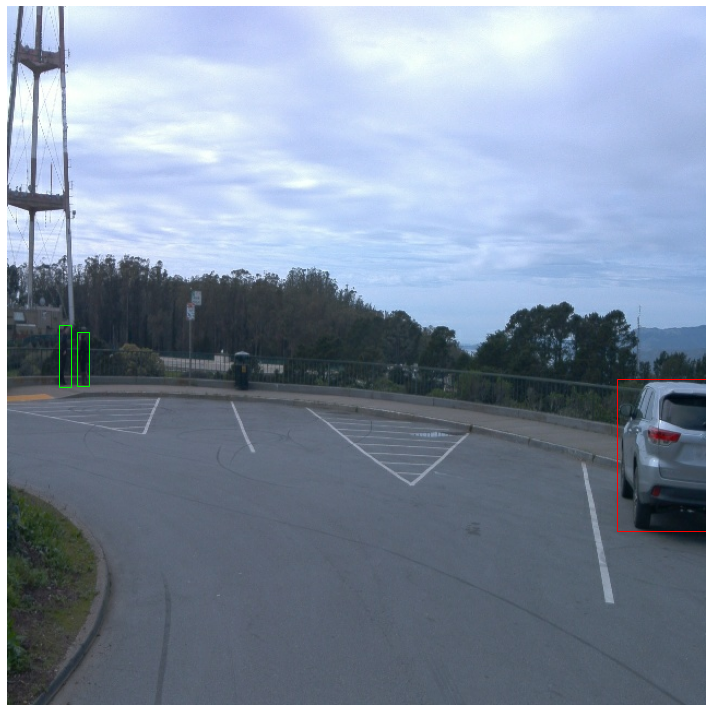

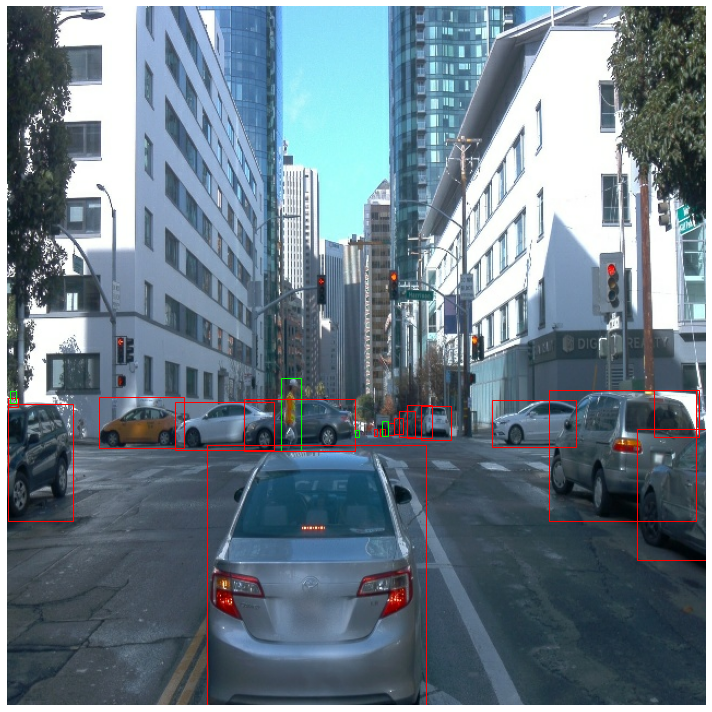

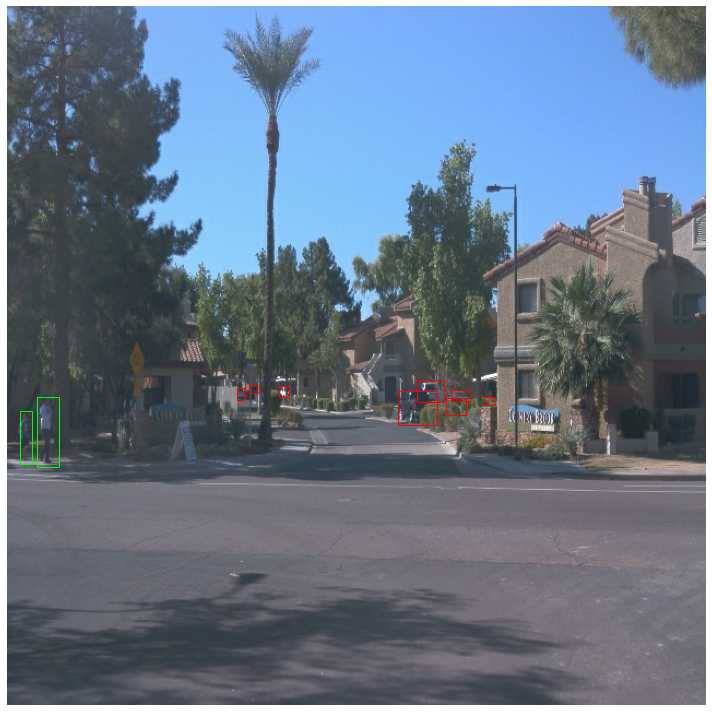

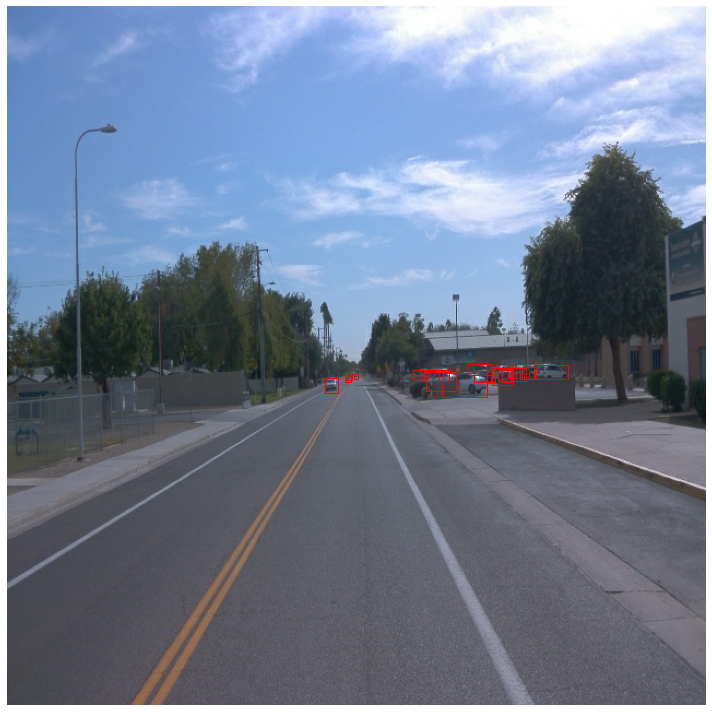

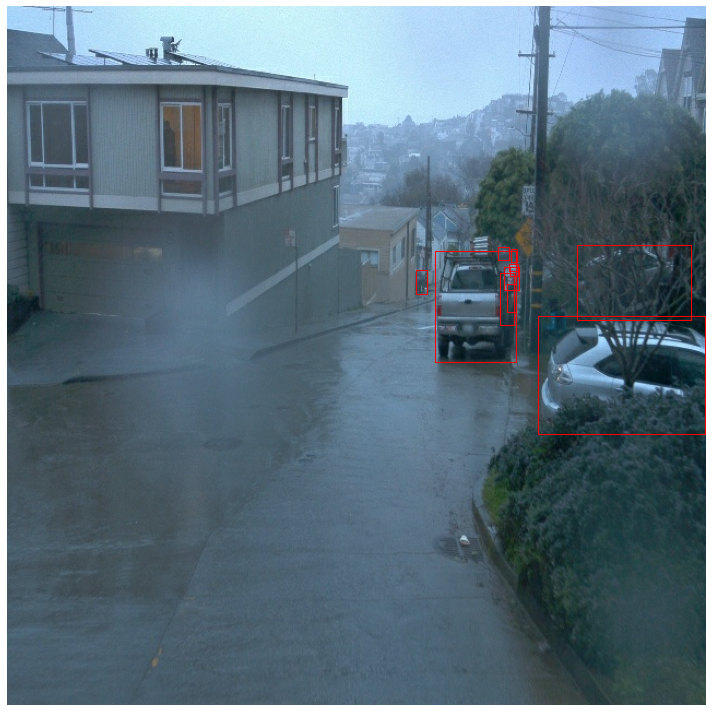

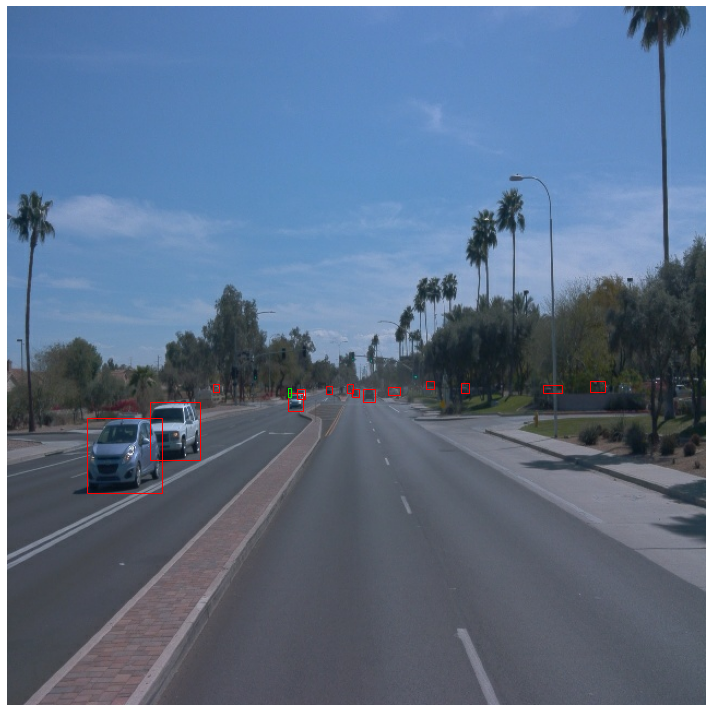

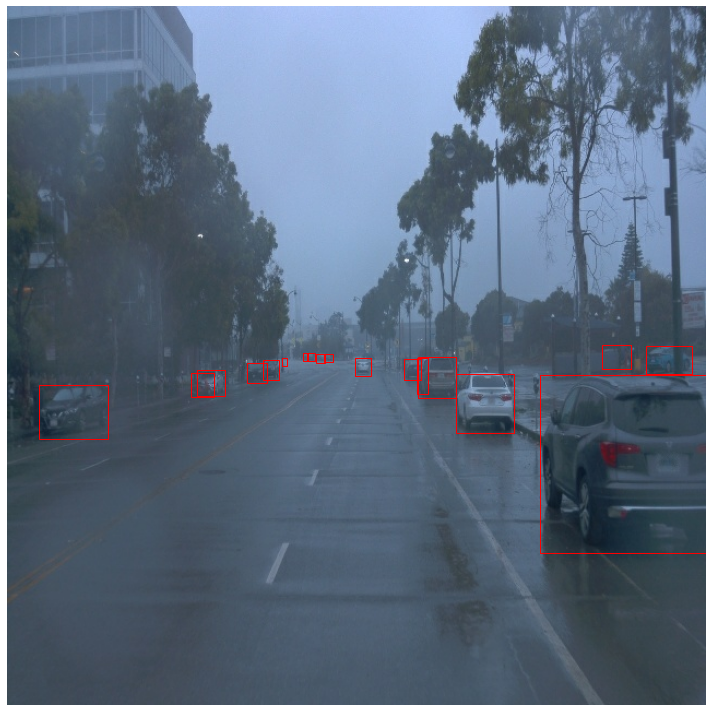

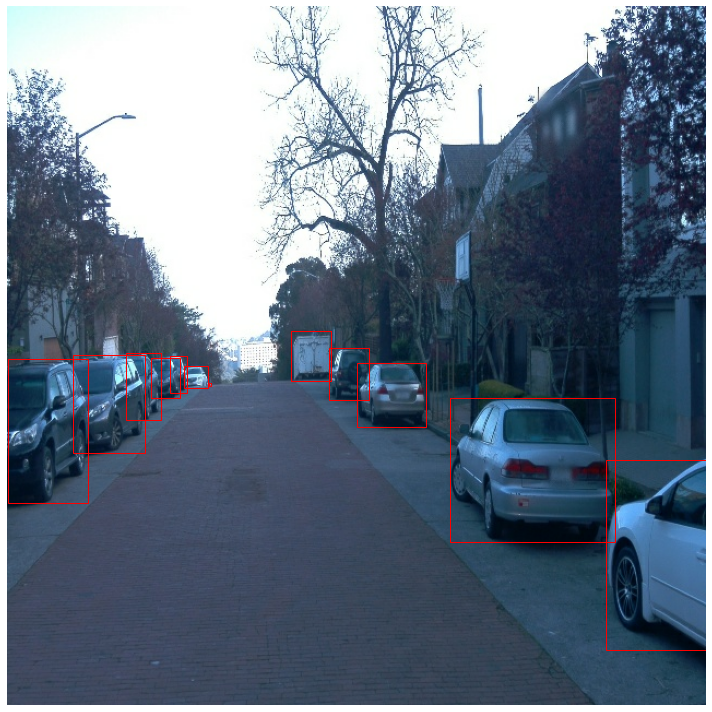

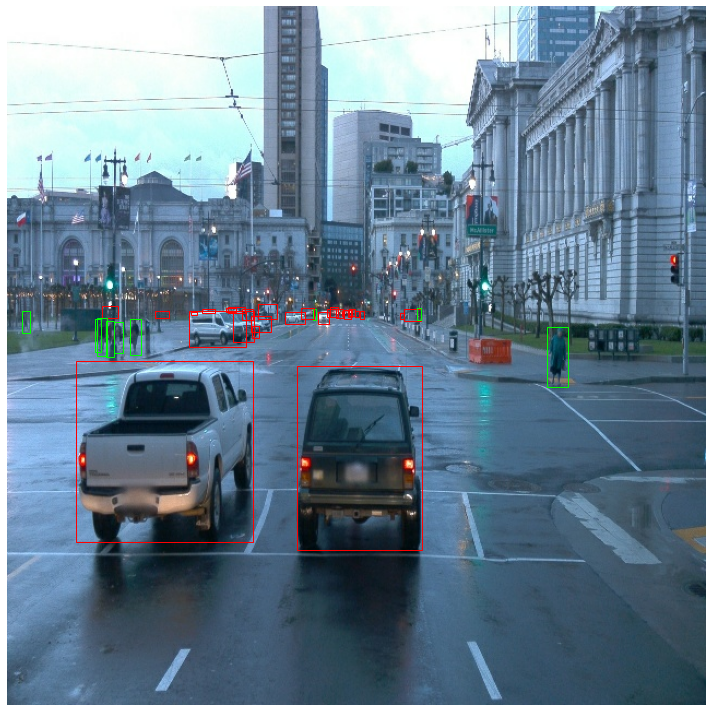

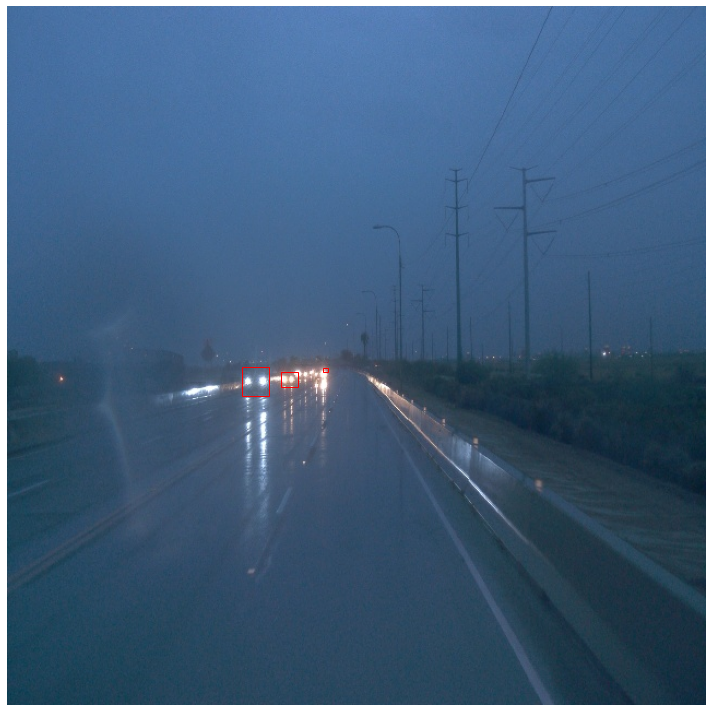

In [25]:
number_of_images = 10
for i in range(number_of_images):
  batch = dataset.take(BATCH_SIZE)
  display_images(batch)

## Additional EDA

In [26]:
labels = {1: 0, 2 : 0, 4: 0 }
labels_dist= {1:[], 2:[], 4:[]}


for batches in dataset.take(2000):
    #map using dict
    try:
        object_count = {1: 0, 2 : 0, 4: 0 }
        for l in batches["groundtruth_classes"].numpy():
            labels[l] += 1
            object_count[l] += 1
            labels_dist[l].append(object_count[l])
    except Exception as err:
        print(err)

In [27]:
labels

{1: 35558, 2: 10246, 4: 233}

[Text(0, 0.5, 'Number of Objects'),
 Text(0.5, 0, 'Classes'),
 Text(0.5, 1.0, 'Distrubution of Classes for 20000 random images')]

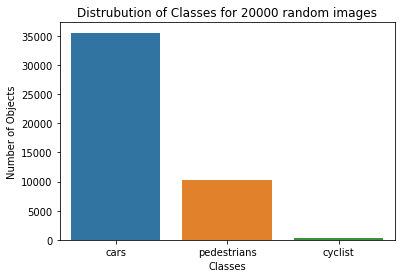

In [28]:
import seaborn as sns

label_map = {"cars": labels[1], "pedestrians": labels[2], "cyclist": labels[4]}
keys = list(label_map.keys())

#Simple dict mapping to convert to labels from strings
vals = [label_map[k] for k in keys]

# plot
ax = sns.barplot(x=keys, y=vals)
ax.set(xlabel='Classes', ylabel='Number of Objects', title='Distrubution of Classes for 20000 random images')

[Text(0, 0.5, 'Number of Images'),
 Text(0.5, 0, 'Number of Cars'),
 Text(0.5, 1.0, 'Distribution of Number of Cars in Images')]

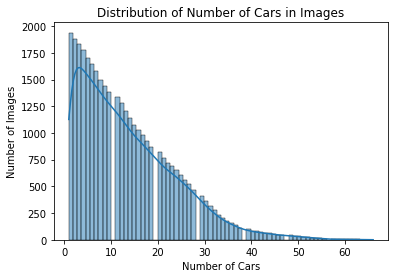

In [29]:
label_dist_map = {"cars": labels_dist[1], "pedestrians": labels_dist[2], "cyclist": labels_dist[4]}
ax_cars = sns.histplot(data=label_dist_map["cars"], kde=True)
ax_cars.set(xlabel='Number of Cars', ylabel='Number of Images', title='Distribution of Number of Cars in Images')

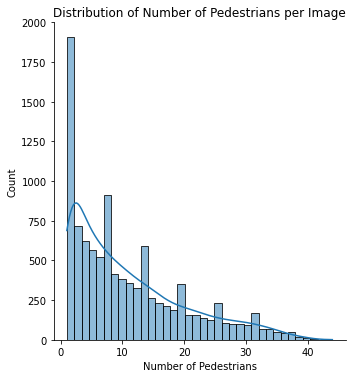

In [30]:
ax_ped= sns.displot(label_dist_map["pedestrians"], kde=True)
ax_ped.set(xlabel='Number of Pedestrians', title='Distribution of Number of Pedestrians per Image')

<Figure size 1080x1080 with 0 Axes>

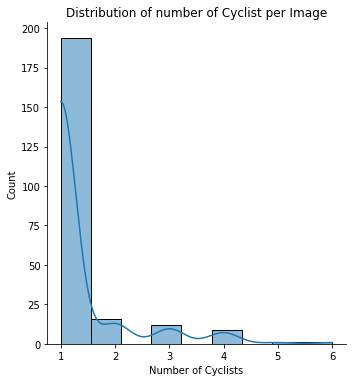

In [31]:
plt.figure(figsize=(15, 15))
ax_cy= sns.displot(label_dist_map["cyclist"], kde=True)
ax_cy.set(xlabel='Number of Cyclists', title='Distribution of number of Cyclist per Image')
plt.show()

## Create the splits

In [ ]:
# all_data = dataset.take(100)
# i = 0
# filename = []
# for data in all_data:
#   i = i + 1
#   filename.append(data["filename"])
  
# print("len of data: ", i)
# print("len of file name: ", len(filename))

In [33]:
def split(source, destination):
    """
    Create three splits from the processed records. The files should be moved to new folders in the
    same directory. This folder should be named train, val and test.

    args:
        - source [str]: source data directory, contains the processed tf records
        - destination [str]: destination data directory, contains 3 sub folders: train / val / test
    """
    files = [filename for filename in glob.glob(f'{source}/*.tfrecord')]
    np.random.shuffle(files)
    train_files, valid_files, test_files = np.split(files, [int(.75*len(files)), int(.9*len(files))])

    train = os.path.join(destination, 'train')
    os.makedirs(train,exist_ok=True)
    for file in train_files:
      shutil.move(file, train)

    valid = os.path.join(destination, 'valid')
    os.makedirs(valid,exist_ok=True)
    for file in valid_files:
      shutil.move(file, valid)

    test = os.path.join(destination, 'test')
    os.makedirs(test,exist_ok=True)
    for file in test_files:
      shutil.move(file, test)    

In [34]:
import glob
import shutil
import numpy as np

source = "/content/nd013-c1-vision-starter/data/processed"
destination = "/content/nd013-c1-vision-starter/data/waymo"
split(source, destination)

In [23]:
#!python create_splits.py --source="/content/nd013-c1-vision-starter/data/processed" --destination="/content/nd013-c1-vision-starter/data/waymo"

2021-12-01 05:27:26,425 INFO     Creating splits...


In [ ]:
# files = [filename for filename in glob.glob(f'{source}/*.tfrecord')]
# print(len(files))
# print(files[:3])

In [ ]:
# np.random.shuffle(files)
# print(files[:3])

In [ ]:
# [int(.75*len(files)), int(.9*len(files))]


In [ ]:
# train_files, valid_files, test_files = np.split(files, [int(.75*len(files)), int(.9*len(files))])

In [ ]:
# len(train_files), len(valid_files), len(test_files)

In [ ]:
# train = os.path.join(destination, 'train')
# os.makedirs(train,exist_ok=True)
# for file in train_files:
#     shutil.move(file, train)

In [ ]:
# valid = os.path.join(destination, 'valid')
# os.makedirs(valid,exist_ok=True)
# for file in valid_files:
#     shutil.move(file, valid)

In [ ]:
# test = os.path.join(destination, 'test')
# os.makedirs(test,exist_ok=True)
# for file in test_files:
#     shutil.move(file, test)    

In [ ]:
#os.remove(source)

## Edit the config file

In [35]:
%pwd

'/content/nd013-c1-vision-starter'

In [ ]:
#!mkdir training
!mkdir experiments/pretrained-models
%cd experiments/pretrained-models/
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

In [ ]:
!tar -zxvf *.tar.gz

In [38]:
%cd /content/nd013-c1-vision-starter/

/content/nd013-c1-vision-starter


In [45]:
!python edit_config.py --train_dir ./data/waymo/train/ --eval_dir ./data/waymo/valid/ --batch_size 2 --checkpoint ./experiments/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0 --label_map label_map.pbtxt

In [46]:
!mkdir experiments/experiment0

In [47]:
!mv pipeline_new.config ./experiments/experiment0/

## Reinstall CUDA and CUDNN

In [ ]:
## https://developer.nvidia.com/cuda-downloads?target_os=Linux&target_arch=x86_64&Distribution=Ubuntu&target_version=18.04&target_type=deb_local

In [ ]:
%cd /content
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin

In [ ]:
!sudo mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget https://developer.download.nvidia.com/compute/cuda/11.5.0/local_installers/cuda-repo-ubuntu1804-11-5-local_11.5.0-495.29.05-1_amd64.deb
!sudo dpkg -i cuda-repo-ubuntu1804-11-5-local_11.5.0-495.29.05-1_amd64.deb
!sudo apt-key add /var/cuda-repo-ubuntu1804-11-5-local/7fa2af80.pub

In [ ]:
!sudo apt-get update
!sudo apt-get -y install cuda

In [ ]:
## https://developer.nvidia.com/rdp/cudnn-archive
## cuDNN Runtime Library for Ubuntu18.04 x86_64 (Deb)

In [ ]:
## login error로 인해 로컬에 다운받았다가 업로드 해야 함
## !wget https://developer.nvidia.com/compute/machine-learning/cudnn/secure/8.1.0.77/11.2_20210127/Ubuntu18_04-x64/libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb

In [51]:
%cd /content
!ls -la

/content
total 2541872
drwxr-xr-x 1 root root       4096 Dec  1 05:44 .
drwxr-xr-x 1 root root       4096 Dec  1 05:09 ..
drwxr-xr-x 8 root root       4096 Dec  1 05:21 cocoapi
drwxr-xr-x 4 root root       4096 Nov 18 14:35 .config
-rw-r--r-- 1 root root 2602833168 Oct 16 01:21 cuda-repo-ubuntu1804-11-5-local_11.5.0-495.29.05-1_amd64.deb
drwx------ 5 root root       4096 Dec  1 05:26 drive
drwxr-xr-x 9 root root       4096 Dec  1 05:44 nd013-c1-vision-starter
drwxr-xr-x 1 root root       4096 Nov 18 14:36 sample_data
drwxr-xr-x 3 root root       4096 Dec  1 05:21 tensorflow
drwxr-xr-x 9 root root       4096 Dec  1 05:24 waymo-od


In [52]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [53]:
%cd drive/MyDrive/CUDNN

/content/drive/MyDrive/CUDNN


In [54]:
!sudo dpkg -i libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb

(Reading database ... 162422 files and directories currently installed.)
Preparing to unpack libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb ...
Unpacking libcudnn8 (8.1.0.77-1+cuda11.2) over (8.0.5.39-1+cuda11.1) ...
Setting up libcudnn8 (8.1.0.77-1+cuda11.2) ...
Processing triggers for libc-bin (2.27-3ubuntu1.3) ...
/sbin/ldconfig.real: /usr/local/lib/python3.7/dist-packages/ideep4py/lib/libmkldnn.so.0 is not a symbolic link



## Training

In [55]:
## for fix the below
## tensorflow.python.framework.errors_impl.OperatorNotAllowedInGraphError: iterating over `tf.Tensor` is not allowed: AutoGraph did convert this function. This might indicate you are trying to use an unsupported feature.

!pip install gast==0.3.3

  Attempting uninstall: gast
    Found existing installation: gast 0.2.2
    Uninstalling gast-0.2.2:
      Successfully uninstalled gast-0.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-text 2.6.0 requires tensorflow<2.7,>=2.6.0, but you have tensorflow 2.7.0 which is incompatible.
tensorflow-io 0.21.0 requires tensorflow<2.7.0,>=2.6.0, but you have tensorflow 2.7.0 which is incompatible.
tensorflow-gpu 2.1.0 requires gast==0.2.2, but you have gast 0.3.3 which is incompatible.
tensorflow-gpu 2.1.0 requires tensorboard<2.2.0,>=2.1.0, but you have tensorboard 2.7.0 which is incompatible.
tensorflow-gpu 2.1.0 requires tensorflow-estimator<2.2.0,>=2.1.0rc0, but you have tensorflow-estimator 2.7.0 which is incompatible.
object-detection 0.1 requires keras==2.6.0, but you have keras 2.7.0 which is incompatible.


In [1]:
%cd /content/nd013-c1-vision-starter/

/content/nd013-c1-vision-starter


#### a training process

In [2]:
!python ./experiments/model_main_tf2.py --model_dir=./experiments/experiment0/ --pipeline_config_path=./experiments/experiment0/pipeline_new.config

2021-12-01 05:50:27.869727: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1201 05:50:27.901476 140306490263424 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1201 05:50:27.925331 140306490263424 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1201 05:50:27.925487 140306490263424 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1201 05:50:28.007375 140306490263424 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:558: StrategyBase.experiment

In [3]:
%load_ext tensorboard
%tensorboard --logdir=experiments/experiment0

<IPython.core.display.Javascript object>

#### an evaluation process

In [4]:
!python ./experiments/model_main_tf2.py --model_dir=./experiments/experiment0/ --pipeline_config_path=./experiments/experiment0/pipeline_new.config --checkpoint_dir=./experiments/experiment0/

W1201 07:14:15.140104 139933604108160 model_lib_v2.py:1082] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1201 07:14:15.140316 139933604108160 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1201 07:14:15.140402 139933604108160 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1201 07:14:15.140488 139933604108160 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1201 07:14:15.140629 139933604108160 model_lib_v2.py:1103] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-12-01 07:14:15.912954: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

In [6]:
%tensorboard --logdir=experiments/experiment0

Reusing TensorBoard on port 6006 (pid 5593), started 0:13:18 ago. (Use '!kill 5593' to kill it.)

<IPython.core.display.Javascript object>

## Explore data augmentations

In [8]:
!mkdir experiments/experiment1
#!cp -r ./experiments/pretrained-models/ ./experiments2/

In [ ]:
#!cp ./experiments/*.py ./experiments2/

In [ ]:
#!cp ./experiments/*.pbtxt ./experiments2/

In [ ]:
#!mkdir ./experiments2/reference

In [9]:
!python edit_config.py --train_dir ./data/waymo/train/ --eval_dir ./data/waymo/valid/ --batch_size 4 --checkpoint ./experiments//pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0 --label_map label_map.pbtxt

In [10]:
!mv pipeline_new.config ./experiments/experiment1/pipeline_new.config

In [ ]:
### Edit pipeline_new.config
'''
data_augmentation_options {
    random_rgb_to_gray {
    probability: 0.2
    }
  }
  data_augmentation_options {
    random_adjust_contrast {
    min_delta: 0.6
    max_delta: 1.0
    }
  }
  data_augmentation_options {
    random_adjust_brightness {
    max_delta: 0.3
    }
  }
'''

#### Helper functions

In [11]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

In [12]:
def recenter_image(image):
    # ssd preprocessing
    image += [123.68, 116.779, 103.939]
    return image

def display_instances(image, bboxes, classes):
    image = recenter_image(image)
    w, h, _ = image.shape
    # resize the bboxes
    bboxes[:, [0, 2]] *= w
    bboxes[:, [1, 3]] *= h
    
    f, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image.astype(np.uint8))
    for bb, cl in zip(bboxes, classes):
        y1, x1, y2, x2 = bb
        rec = Rectangle((x1, y1), x2-x1, y2-y1, facecolor='none', edgecolor='r', linewidth=2)
        ax.add_patch(rec)
    plt.show()

def display_batch(batch):
    # get images, bboxes and classes
    batched_images = batch[0]['image'].numpy()
    batched_bboxes = batch[1]['groundtruth_boxes'].numpy()
    batched_classes = batch[1]['groundtruth_classes'].numpy()
    num_bboxes = batch[1]['num_groundtruth_boxes'].numpy()
    batch_size = batched_images.shape[0]
    for idx in range(batch_size):
        display_instances(batched_images[idx, ...], 
                          batched_bboxes[idx, :num_bboxes[idx], :],
                          batched_classes[idx, ...])

#### Display augmentations

In [13]:
from utils import get_train_input

In [14]:
%pwd

'/content/nd013-c1-vision-starter'

In [15]:
train_dataset = get_train_input("./experiments/experiment1/pipeline_new.config")

INFO:tensorflow:Reading unweighted datasets: ['./data/waymo/train/segment-1022527355599519580_4866_960_4886_960_with_camera_labels.tfrecord', './data/waymo/train/segment-10094743350625019937_3420_000_3440_000_with_camera_labels.tfrecord', './data/waymo/train/segment-10096619443888687526_2820_000_2840_000_with_camera_labels.tfrecord', './data/waymo/train/segment-11119453952284076633_1369_940_1389_940_with_camera_labels.tfrecord', './data/waymo/train/segment-11219370372259322863_5320_000_5340_000_with_camera_labels.tfrecord', './data/waymo/train/segment-11454085070345530663_1905_000_1925_000_with_camera_labels.tfrecord', './data/waymo/train/segment-10498013744573185290_1240_000_1260_000_with_camera_labels.tfrecord', './data/waymo/train/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord', './data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', './data/waymo/train/segment-10275144660749673822_5755_561_5775_561_with_camera_lab

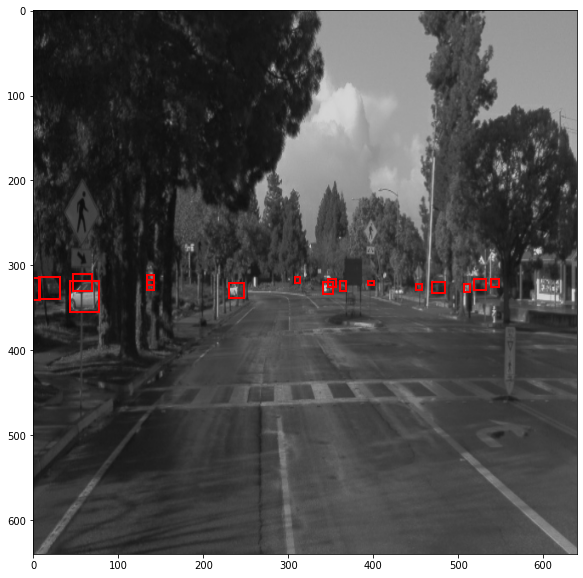

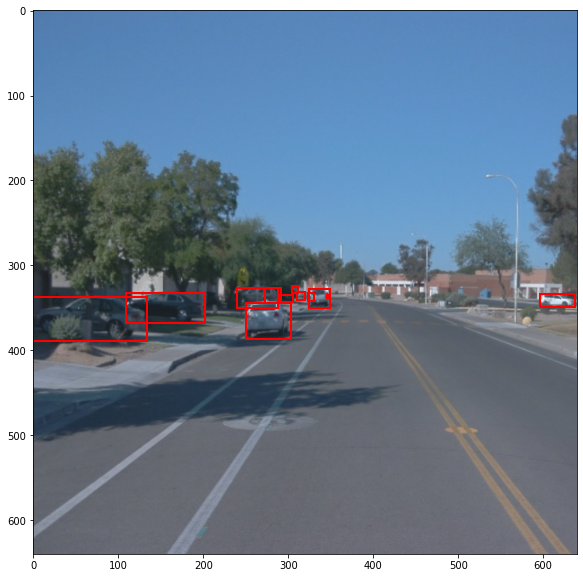

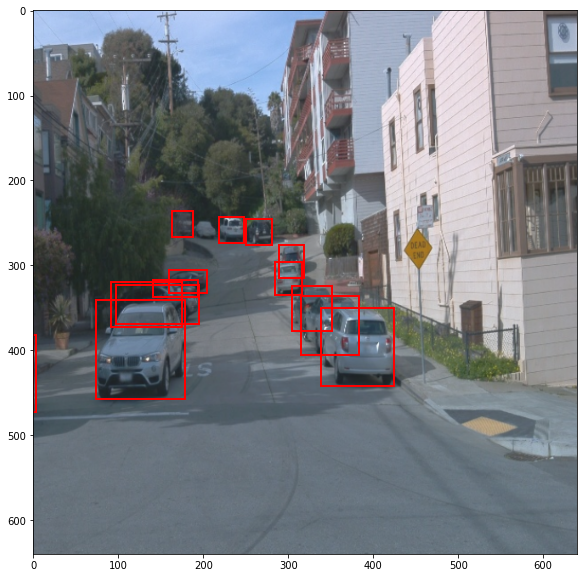

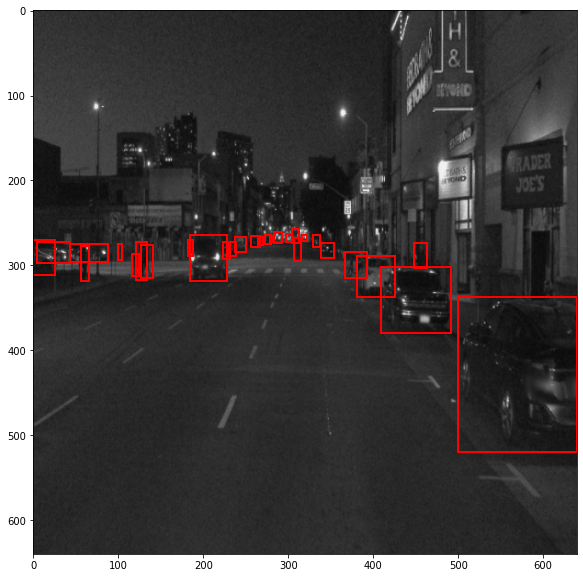

In [16]:
%matplotlib inline

for batch in train_dataset.take(1):
    display_batch(batch)

## Train with Augmented dataset

In [ ]:
%pwd

'/content/nd013-c1-vision-starter'

#### a training process

In [17]:
!python ./experiments/model_main_tf2.py --model_dir=./experiments/experiment1/ --pipeline_config_path=./experiments/experiment1/pipeline_new.config

2021-12-01 07:30:19.925445: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1201 07:30:19.928661 140400373315456 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1201 07:30:19.935064 140400373315456 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1201 07:30:19.935209 140400373315456 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1201 07:30:19.960087 140400373315456 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:558: StrategyBase.experiment

#### an evaluation process

In [18]:
!python ./experiments/model_main_tf2.py --model_dir=./experiments/experiment1/ --pipeline_config_path=./experiments/experiment1/pipeline_new.config --checkpoint_dir=./experiments/experiment1/

W1201 09:44:27.676907 139672751318912 model_lib_v2.py:1082] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1201 09:44:27.677101 139672751318912 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1201 09:44:27.677160 139672751318912 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1201 09:44:27.677217 139672751318912 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1201 09:44:27.677302 139672751318912 model_lib_v2.py:1103] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-12-01 09:44:28.455681: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

In [19]:
%load_ext tensorboard
%tensorboard --logdir=experiments/experiment1

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Creating an animation

In [20]:
!mkdir ./experiments/experiment1/exported_model

In [21]:
!python ./experiments/exporter_main_v2.py --input_type image_tensor --pipeline_config_path ./experiments/experiment1/pipeline_new.config --trained_checkpoint_dir experiments/experiment1 --output_directory ./experiments/experiment1/exported_model/

2021-12-01 09:57:10.181030: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1201 09:57:10.436873 140219535001472 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1201 09:57:26.365261 14021953500

In [22]:
!python inference_video.py --labelmap_path label_map.pbtxt --model_path ./experiments/experiment1/exported_model/saved_model --tf_record_path ./data/waymo/test/segment-10075870402459732738_1060_000_1080_000_with_camera_labels.tfrecord --config_path ./experiments/experiment1/pipeline_new.config --output_path animation.mp4

2021-12-01 10:01:50,645 INFO     Loading model from ./experiments/experiment1/exported_model/saved_model
2021-12-01 10:01:51.983975: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
2021-12-01 10:02:03,060 INFO     Loading config from ./experiments/experiment1/pipeline_new.config
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()
2021-12-01 10:02:04,766 INFO     Inference on ./data/waymo/test/segment-10075870402459732738_1060_000_1080_000_with_camera_labels.tfrecord
2021-12-01 10:02:04,839 INFO     Step: 0
2021-12-01 10:02:08,275 INFO     Step: 10


In [ ]:
!python inference_video.py --labelmap_path label_map.pbtxt --model_path ./experiments/experiment1/exported_model/saved_model --tf_record_path ./data/waymo/test/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord --config_path ./experiments/experiment1/pipeline_new.config --output_path animation2.mp4

2021-11-30 05:52:34,432 INFO     Loading model from ./experiments2/reference/exported_model/saved_model
2021-11-30 05:52:35.730706: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
2021-11-30 05:52:46,746 INFO     Loading config from ./experiments2/reference/pipeline_new.config
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()
2021-11-30 05:52:48,468 INFO     Inference on ./data/waymo/test/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord
2021-11-30 05:52:48,561 INFO     Step: 0
2021-11-30 05:52:52,327 INFO     Step: 10
